In [1]:
import pandas as pd
import numpy as np
import yaml
import lightgbm as lgb
import os
from datetime import datetime, timedelta
import os

In [3]:
model = lgb.Booster(model_file="/home/kenny/TradingExperiments/reports/experiments_results/exp_3/lgb_model.txt")

In [10]:
feature_importance = model.feature_importance()

<Figure size 6000x12000 with 0 Axes>

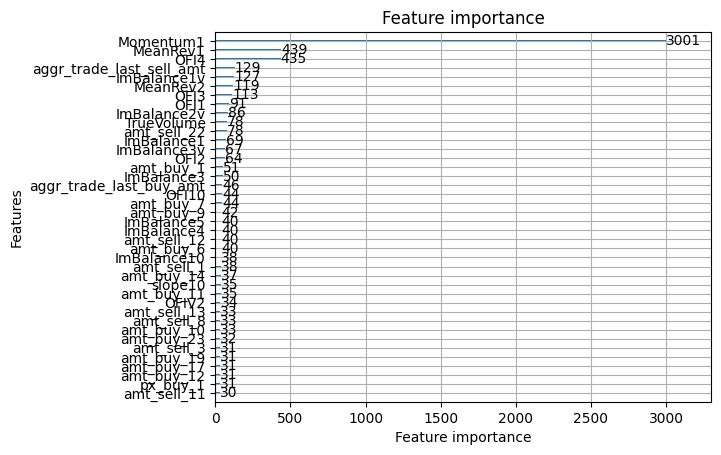

In [28]:
import matplotlib.pyplot as plt

plt.figure(figsize=(60, 120))
lgb.plot_importance(model, max_num_features=40)
plt.show()

In [4]:
data_dir_path = "/home/kenny/data"

In [ ]:
temp = [os.path.join(data_dir_path, x) for x in os.listdir(data_dir_path)]

NameError: name 'data_dir_path' is not defined

In [ ]:
temp

In [5]:
data_path = "/home/kenny/data/BTCUSDT_2023_04_02.csv"

In [4]:
model_path = "/home/kenny/TradingExperiments/experiments_results/exp_1/lgb_model.txt"

In [6]:
chunk_size = 1000000

for chunk in pd.read_csv(data_path, chunksize=chunk_size, sep="|", iterator=True):
    first_chunk = chunk.iloc[10:]
    break    

In [7]:
first_chunk

,px_buy_1,amt_buy_1,px_buy_2,amt_buy_2,px_buy_3,amt_buy_3,px_buy_4,amt_buy_4,px_buy_5,amt_buy_5,...,amt_sell_25,aggr_trade_last_buy_px,aggr_trade_last_buy_amt,aggr_trade_last_buy_cnt,aggr_trade_last_sell_px,aggr_trade_last_sell_amt,aggr_trade_last_sell_cnt,adapter_time,host_time,sent_time
10,28440.9,14.629,28440.7,0.715,28440.6,0.598,28440.5,1.00,28440.4,0.001,...,0.623,28441.0,0.117,2,28440.9,3.428,3,1680393808887237383,1680393807132000000,1680393807140000000
11,28440.9,14.629,28440.7,0.715,28440.6,0.598,28440.5,1.00,28440.4,0.001,...,0.623,28441.0,0.022,2,28440.9,3.428,3,1680393808887237383,1680393807132000000,1680393807140000000
12,28440.9,13.018,28440.7,0.715,28440.6,0.598,28440.5,1.00,28440.4,0.001,...,0.546,28441.0,0.022,2,28440.9,3.428,3,1680393808887350712,1680393807167000000,1680393807172000000
13,28440.9,13.018,28440.7,0.715,28440.6,0.598,28440.5,1.00,28440.4,0.001,...,0.546,28441.0,0.022,2,28440.9,1.611,2,1680393808887539636,1680393807200000000,1680393807208000000
14,28440.9,13.018,28440.7,0.715,28440.6,0.598,28440.5,1.00,28440.4,0.001,...,0.546,28441.0,0.022,2,28440.9,1.611,2,1680393808887653378,1680393807233000000,1680393807240000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,28382.7,5.172,28382.6,0.241,28382.4,0.178,28382.3,0.37,28382.1,0.003,...,0.419,28382.8,0.012,1,28382.7,0.186,1,1680426728683666948,1680426728524000000,1680426728534000000
999996,28382.7,5.172,28382.6,0.241,28382.4,0.178,28382.3,0.37,28382.1,0.003,...,0.419,28382.8,0.012,1,28382.7,0.186,1,1680426728782353263,1680426728628000000,1680426728633000000
999997,28382.7,5.172,28382.6,0.241,28382.4,0.178,28382.3,0.37,28382.1,0.003,...,0.419,28382.8,0.012,1,28382.7,0.186,1,1680426728817218752,1680426728660000000,1680426728667000000
999998,28382.7,6.937,28382.6,0.241,28382.4,0.178,28382.3,0.37,28382.1,0.003,...,0.369,28382.8,0.012,1,28382.7,0.186,1,1680426728848684506,1680426728690000000,1680426728699000000


In [8]:
import sys
sys.path.insert(1, '/home/kenny/TradingExperiments/src')

In [9]:
from clean import read_data, feature_creation

first_chunk = read_data(first_chunk)
first_chunk = feature_creation(first_chunk)

In [10]:
# Load the model from file
model = lgb.Booster(model_file=model_path)

NameError: name 'model_path' is not defined

In [11]:
X_train = first_chunk.drop(["LagTruePrice"], axis=1)
y_train = first_chunk["LagTruePrice"]

In [12]:
y_predict = model.predict(X_train)

In [13]:
first_chunk["predicted"] = y_predict
first_chunk[["LagTruePrice", "predicted"]]

,LagTruePrice,predicted
adapter_time,,
2023-04-02 00:03:28.887237383,0.0,-0.001857
2023-04-02 00:03:28.887237383,0.0,-0.001867
2023-04-02 00:03:28.887350712,0.0,-0.001545
2023-04-02 00:03:28.887539636,0.0,-0.002244
2023-04-02 00:03:28.887653378,0.0,-0.001610
...,...,...
2023-04-02 09:12:08.683666948,0.0,-0.002123
2023-04-02 09:12:08.782353263,0.0,-0.001010
2023-04-02 09:12:08.817218752,0.0,-0.001010


In [14]:
import matplotlib.pyplot as plt
import seaborn as sns

In [15]:
df = first_chunk[["px_buy_1", "px_sell_1", "LagTruePrice", "predicted", "TruePrice"]].head(1000)

In [16]:
df['PredictedPrice'] = df["TruePrice"] + df["predicted"].shift(1).fillna(0)

In [17]:
df["PreviousMidPrice"] = df["TruePrice"].shift(1).fillna(0)
df

,px_buy_1,px_sell_1,LagTruePrice,predicted,TruePrice,PredictedPrice,PreviousMidPrice
adapter_time,,,,,,,
2023-04-02 00:03:28.887237383,28440.9,28441.0,0.0,-0.001857,28440.95,28440.950000,0.00
2023-04-02 00:03:28.887237383,28440.9,28441.0,0.0,-0.001867,28440.95,28440.948143,28440.95
2023-04-02 00:03:28.887350712,28440.9,28441.0,0.0,-0.001545,28440.95,28440.948133,28440.95
2023-04-02 00:03:28.887539636,28440.9,28441.0,0.0,-0.002244,28440.95,28440.948455,28440.95
2023-04-02 00:03:28.887653378,28440.9,28441.0,0.0,-0.001610,28440.95,28440.947756,28440.95
...,...,...,...,...,...,...,...
2023-04-02 00:03:56.821860447,28442.9,28443.0,0.0,0.001981,28442.95,28442.947103,28442.95
2023-04-02 00:03:56.853864687,28442.9,28443.0,0.0,0.001800,28442.95,28442.951981,28442.95
2023-04-02 00:03:56.885731042,28442.9,28443.0,0.0,-0.000675,28442.95,28442.951800,28442.95


In [ ]:
for index, row in df.iterrows():


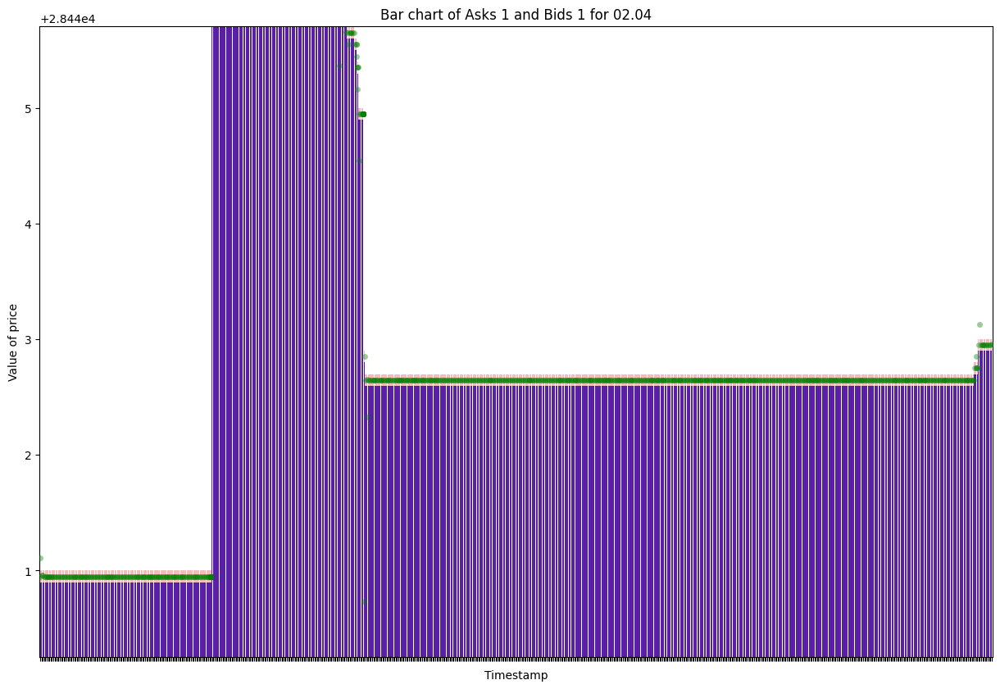

In [19]:
plt.figure(figsize=(15, 10))
# create a bar plot using seaborn
plot1 = sns.barplot(data=df, x=df.index, y='px_buy_1', alpha=1, color="blue")

plot2 = sns.barplot(data=df, x=df.index, y='px_sell_1', alpha=0.3, color="red")

# plot3 = sns.barplot(data=df, x=df.index, y='PredictedPrice', alpha=0.5, color="green")

plot3 = sns.stripplot(data=df, x=df.index, y='PredictedPrice', alpha = 0.4, color='green')

# set the x-axis label
plt.xlabel('Timestamp')

# set the y-axis label
plt.ylabel('Value of price')

# set the title of the plot
plt.title('Bar chart of Asks 1 and Bids 1 for 02.04')
plot1.set_xticklabels([])
plot1.set(ylim=(df['px_buy_1'].mean() - 3,df['px_buy_1'].mean()+ df['px_buy_1'].std()))
plot2.set_xticklabels([])
plot2.set(ylim=(df['px_buy_1'].mean() - 3,df['px_buy_1'].mean()+ df['px_buy_1'].std()))
plot3.set_xticklabels([])
plot3.set(ylim=(df['px_buy_1'].mean() - 3,df['px_buy_1'].mean()+ df['px_buy_1'].std()))
# plot1.set(xlim=(2, 10))
plt.show()

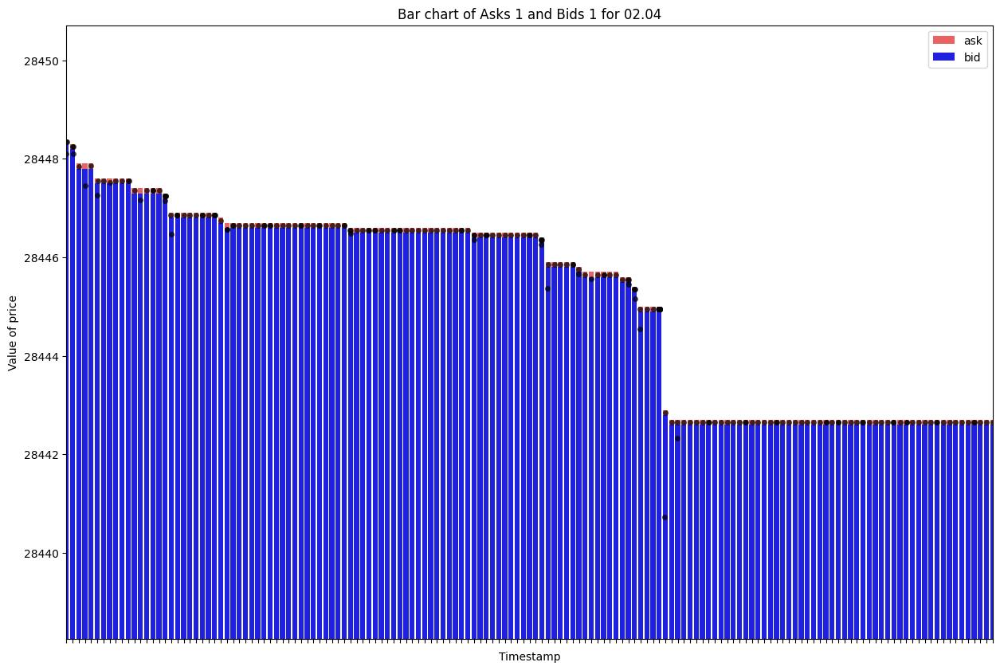

In [20]:
plt.figure(figsize=(15, 10))

# create a bar plot using seaborn
plot1 = sns.barplot(data=df, x=df.index, y='px_sell_1', alpha=0.7, color="red", label="ask")

plot2 = sns.stripplot(data=df, x=df.index, y='PredictedPrice', alpha = 0.7, color='black')

plot3 = sns.barplot(data=df, x=df.index, y='px_buy_1', alpha=1, color="blue", label="bid")

# plot3 = sns.stripplot(data=df, x=df.index, y='PredictedPrice', alpha = 0.4, color='green')

# set the x-axis label
plt.xlabel('Timestamp')

# set the y-axis label
plt.ylabel('Value of price')

# set the title of the plot
plt.title('Bar chart of Asks 1 and Bids 1 for 02.04')
plot1.set_xticklabels([])
plot1.set(ylim=(df['px_buy_1'].mean() - 5,df['px_buy_1'].mean()+ df['px_buy_1'].std()+5), xlim=(150,300))
plot2.set_xticklabels([])
plot2.set(ylim=(df['px_buy_1'].mean() - 5,df['px_buy_1'].mean()+ df['px_buy_1'].std()+5), xlim=(150,300))
plot3.set_xticklabels([])
plot3.set(ylim=(df['px_buy_1'].mean() - 5,df['px_buy_1'].mean()+ df['px_buy_1'].std()+5), xlim=(150,300))
plt.legend()
plt.show()

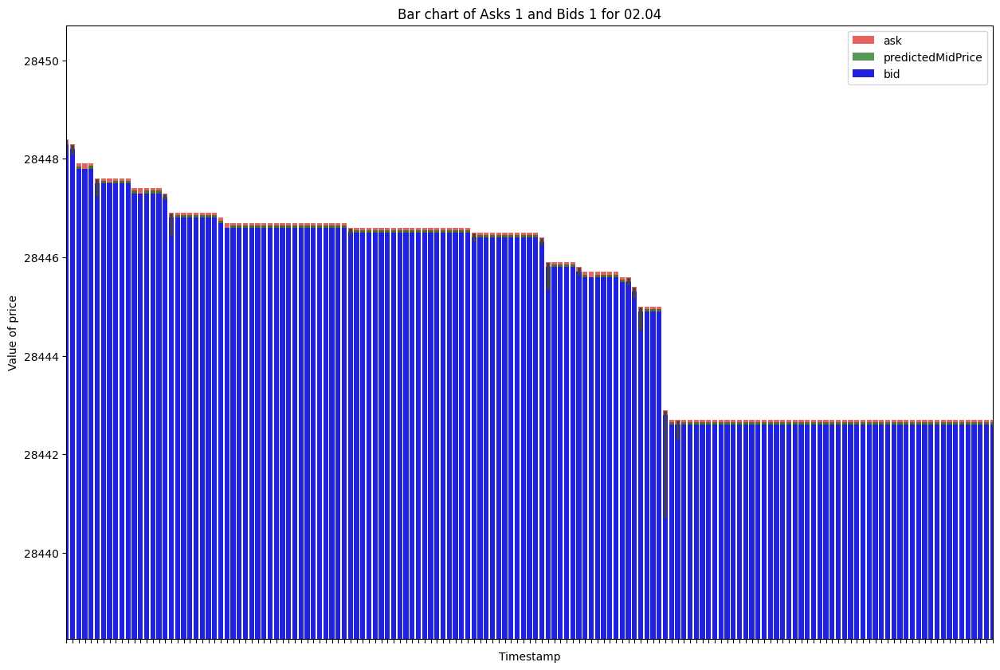

In [21]:
plt.figure(figsize=(15, 10))

# create a bar plot using seaborn
plot1 = sns.barplot(data=df, x=df.index, y='px_sell_1', alpha=0.7, color="red", label="ask")

plot2 = sns.barplot(data=df, x=df.index, y='PredictedPrice', alpha=0.7, color="green", label="predictedMidPrice")

plot3 = sns.barplot(data=df, x=df.index, y='px_buy_1', alpha=1, color="blue", label="bid")

# plot3 = sns.stripplot(data=df, x=df.index, y='PredictedPrice', alpha = 0.4, color='green')

# set the x-axis label
plt.xlabel('Timestamp')

# set the y-axis label
plt.ylabel('Value of price')

# set the title of the plot
plt.title('Bar chart of Asks 1 and Bids 1 for 02.04')
plot1.set_xticklabels([])
plot1.set(ylim=(df['px_buy_1'].mean() - 5,df['px_buy_1'].mean()+ df['px_buy_1'].std()+5), xlim=(150,300))
plot2.set_xticklabels([])
plot2.set(ylim=(df['px_buy_1'].mean() - 5,df['px_buy_1'].mean()+ df['px_buy_1'].std()+5), xlim=(150,300))
plot3.set_xticklabels([])
plot3.set(ylim=(df['px_buy_1'].mean() - 5,df['px_buy_1'].mean()+ df['px_buy_1'].std()+5), xlim=(150,300))
plt.legend()
# plot1.set(xlim=(2, 10))
plt.show()

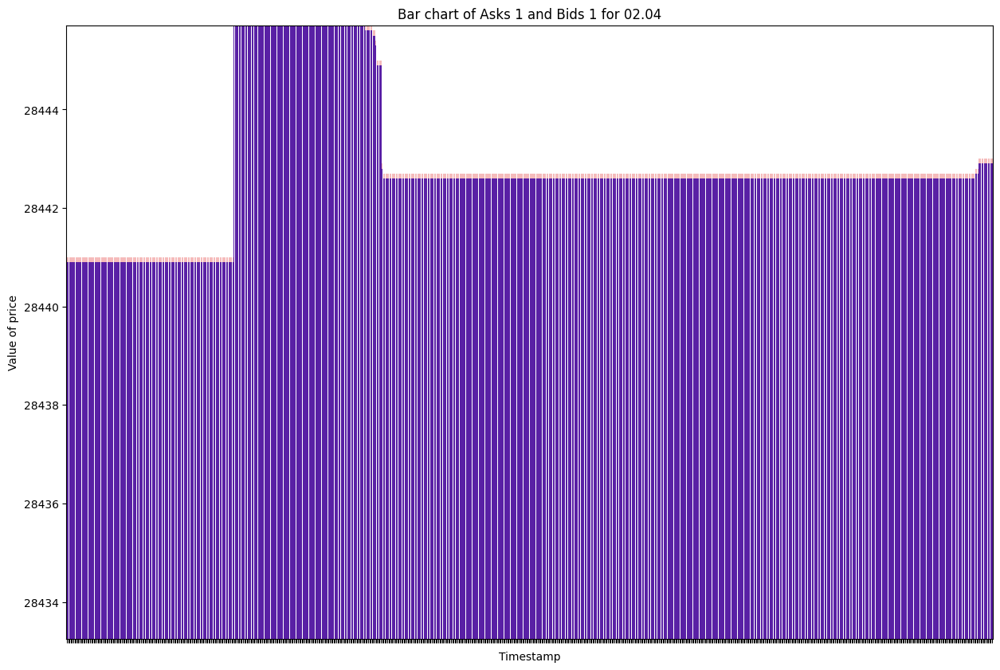

In [22]:
plt.figure(figsize=(15, 10))
# create a bar plot using seaborn
plot1 = sns.barplot(data=df, x=df.index, y='px_buy_1', alpha=1, color="blue")

plot2 = sns.barplot(data=df, x=df.index, y='px_sell_1', alpha=0.3, color="red")

# plot3 = sns.barplot(data=df, x=df.index, y='PredictedPrice', alpha=0.5, color="green")

# plot3 = sns.stripplot(data=df, x=df.index, y='PredictedPrice', alpha = 0.4, color='green')

# set the x-axis label
plt.xlabel('Timestamp')

# set the y-axis label
plt.ylabel('Value of price')

# set the title of the plot
plt.title('Bar chart of Asks 1 and Bids 1 for 02.04')
plot1.set_xticklabels([])
plot1.set(ylim=(df['px_buy_1'].mean() - 10,df['px_buy_1'].mean()+ df['px_buy_1'].std()))
plot2.set_xticklabels([])
plot2.set(ylim=(df['px_buy_1'].mean() - 10,df['px_buy_1'].mean()+ df['px_buy_1'].std()))
# plot3.set_xticklabels([])
# plot3.set(ylim=(df['px_buy_1'].mean() - 10,df['px_buy_1'].mean()+ df['px_buy_1'].std()))
# plot1.set(xlim=(2, 10))
plt.show()

In [5]:
X_train = data.head(100000).drop(["host_time", "sent_time", "TruePrice"], axis=1)
y_train = data.head(100000)["TruePrice"]

In [8]:
from sklearn.metrics import mean_squared_error
# Load best hyperparameters from YAML file
with open(params_config, 'r') as f:
    best_params = yaml.safe_load(f)

# Train and evaluate model using best hyperparameters
model = lgb.train(best_params, lgb.Dataset(X_train, y_train), verbose_eval=False)
y_pred = model.predict(X_train)
mse = mean_squared_error(y_train, y_pred)
print('Best model trained with MSE:', mse)

/home/kenny/miniconda3/envs/algotrading/lib/python3.10/site-packages/lightgbm/engine.py:177: UserWarning: Found `num_boost_round` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
/home/kenny/miniconda3/envs/algotrading/lib/python3.10/site-packages/lightgbm/engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 34680
[LightGBM] [Info] Number of data points in the train set: 100000, number of used features: 140
[LightGBM] [Info] Start training from score 28468.303261
Best model trained with MSE: 1204.3504707584932


In [9]:
model.params

{'bagging_fraction': 0.4883012752479061,
 'bagging_freq': 8,
 'feature_fraction': 0.1321802426035132,
 'lambda_l1': 0.0678347271226502,
 'lambda_l2': 4.070812026259327e-08,
 'learning_rate': 1.8601617261301287e-05,
 'min_child_samples': 9,
 'num_leaves': 162,
 'num_iterations': 740,
 'early_stopping_round': None}

In [ ]:
# Load trained model from JSON file
with open('model.json', 'r') as f:
    model_json = json.load(f)
lgb_model_loaded = lgb.Booster(model_file=None, model_str=json.dumps(model_json))

In [26]:
import json
path_to_model = "/home/kenny/TradingExperiments/experiments_results/exp_1/model.txt"
# # Load the JSON file containing the model
# with open(path_to_model, 'r') as f:
#     model_json = json.loads(f)

# # Load the model using the JSON string
model = lgb.Booster(model_file=path_to_model)

In [27]:
model

In [13]:
# Load the JSON file into a dictionary
with open(path_to_model, 'r') as f:
    model_dict = json.load(f)

# Load the model from the dictionary
loaded_model = lgb.Booster(model_file=None, model_str=json.dumps(model_dict))

[LightGBM] [Fatal] Wrong line at model file: {"name": "tree", "version": "v3", "num_class": 1, "num_tree_per_iteration": 1, "label_index": 0, "max_feature_idx": 139, "object


LightGBMError: Wrong line at model file: {"name": "tree", "version": "v3", "num_class": 1, "num_tree_per_iteration": 1, "label_index": 0, "max_feature_idx": 139, "object

In [19]:
with open(path_to_model, 'r') as f:
    # Load the contents of the file into a variable
    data = json.load(f)

In [20]:
data

{'name': 'tree',
 'version': 'v3',
 'num_class': 1,
 'num_tree_per_iteration': 1,
 'label_index': 0,
 'max_feature_idx': 139,
 'objective': 'regression',
 'average_output': False,
 'feature_names': ['px_buy_1',
  'amt_buy_1',
  'px_buy_2',
  'amt_buy_2',
  'px_buy_3',
  'amt_buy_3',
  'px_buy_4',
  'amt_buy_4',
  'px_buy_5',
  'amt_buy_5',
  'px_buy_6',
  'amt_buy_6',
  'px_buy_7',
  'amt_buy_7',
  'px_buy_8',
  'amt_buy_8',
  'px_buy_9',
  'amt_buy_9',
  'px_buy_10',
  'amt_buy_10',
  'px_buy_11',
  'amt_buy_11',
  'px_buy_12',
  'amt_buy_12',
  'px_buy_13',
  'amt_buy_13',
  'px_buy_14',
  'amt_buy_14',
  'px_buy_15',
  'amt_buy_15',
  'px_buy_16',
  'amt_buy_16',
  'px_buy_17',
  'amt_buy_17',
  'px_buy_18',
  'amt_buy_18',
  'px_buy_19',
  'amt_buy_19',
  'px_buy_20',
  'amt_buy_20',
  'px_buy_21',
  'amt_buy_21',
  'px_buy_22',
  'amt_buy_22',
  'px_buy_23',
  'amt_buy_23',
  'px_buy_24',
  'amt_buy_24',
  'px_buy_25',
  'amt_buy_25',
  'px_sell_1',
  'amt_sell_1',
  'px_sell_2',


In [24]:
model = lgb.Booster(model_file=None, model_str=json.dumps(data))

[LightGBM] [Fatal] Wrong line at model file: {"name": "tree", "version": "v3", "num_class": 1, "num_tree_per_iteration": 1, "label_index": 0, "max_feature_idx": 139, "object


LightGBMError: Wrong line at model file: {"name": "tree", "version": "v3", "num_class": 1, "num_tree_per_iteration": 1, "label_index": 0, "max_feature_idx": 139, "object

In [1]:
import catboost as cb

In [2]:
params = {
    "max_depth": 12,
    "n_estimators": 20,
    "num_leaves": 4096,
}

In [4]:
model = cb.CatBoost()
model.set_params(**params)

In [6]:
model.get_params()

{'max_depth': 12, 'n_estimators': 20, 'num_leaves': 4096}